# Ch `08`: Concept `01`

## Reinforcement learning

The **states** are previous history of stock prices, current budget, and current number of shares of a stock.

The **actions** are buy, sell, or hold (i.e. do nothing).

The stock market data comes from the Yahoo Finance library, `pip install yahoo-finance`.

In [6]:
%matplotlib inline
from yahoo_finance import Share
from matplotlib import pyplot as plt
import numpy as np
import random
import tensorflow as tf
import random

Define an abstract class called `DecisionPolicy`:

In [7]:
class DecisionPolicy:
    def select_action(self, current_state, step):
        pass

    def update_q(self, state, action, reward, next_state):
        pass

Here's one way we could implement the decision policy, called a random decision policy:

In [8]:
class RandomDecisionPolicy(DecisionPolicy):
    def __init__(self, actions):
        self.actions = actions

    def select_action(self, current_state, step):
        action = random.choice(self.actions)
        return action

That's a good baseline. Now let's use a smarter approach using a neural network:

In [10]:
class QLearningDecisionPolicy(DecisionPolicy):
    def __init__(self, actions, input_dim):
        self.epsilon = 0.9
        self.gamma = 0.001
        self.actions = actions
        output_dim = len(actions)
        h1_dim = 200

        self.x = tf.placeholder(tf.float32, [None, input_dim])
        self.y = tf.placeholder(tf.float32, [output_dim])
        W1 = tf.Variable(tf.random_normal([input_dim, h1_dim]))
        b1 = tf.Variable(tf.constant(0.1, shape=[h1_dim]))
        h1 = tf.nn.relu(tf.matmul(self.x, W1) + b1)
        W2 = tf.Variable(tf.random_normal([h1_dim, output_dim]))
        b2 = tf.Variable(tf.constant(0.1, shape=[output_dim]))
        self.q = tf.nn.relu(tf.matmul(h1, W2) + b2)

        loss = tf.square(self.y - self.q)
        self.train_op = tf.train.AdagradOptimizer(0.01).minimize(loss)
        self.sess = tf.Session()
        self.sess.run(tf.global_variables_initializer())

    def select_action(self, current_state, step):
        threshold = min(self.epsilon, step / 1000.)
        if random.random() < threshold:
            # Exploit best option with probability epsilon
            action_q_vals = self.sess.run(self.q, feed_dict={self.x: current_state})
        
            print "====select_action==self.q======="
            print self.q
            print "====select_action self.x​ ======="
            print  self.x  
            action_idx = np.argmax(action_q_vals)  # TODO: replace w/ tensorflow's argmax
            action = self.actions[action_idx]
        else:
            # Explore random option with probability 1 - epsilon
            action = self.actions[random.randint(0, len(self.actions) - 1)]
        return action

    def update_q(self, state, action, reward, next_state):
        action_q_vals = self.sess.run(self.q, feed_dict={self.x: state})
        next_action_q_vals = self.sess.run(self.q, feed_dict={self.x: next_state})
        next_action_idx = np.argmax(next_action_q_vals)
        action_q_vals[0, next_action_idx] = reward + self.gamma * next_action_q_vals[0, next_action_idx]
        action_q_vals = np.squeeze(np.asarray(action_q_vals))
        self.sess.run(self.train_op, feed_dict={self.x: state, self.y: action_q_vals})
        print "==== update_q==self.x======="
        print self.x
        print "==== update_q  self.y​ ======="
        print  self.y  

Define a function to run a simulation of buying and selling stocks from a market:

In [11]:
def run_simulation(policy, initial_budget, initial_num_stocks, prices, hist, debug=False):
    budget = initial_budget
    num_stocks = initial_num_stocks
    share_value = 0
    transitions = list()
    for i in range(len(prices) - hist - 1):
        if i % 100 == 0:
            print('progress {:.2f}%'.format(float(100*i) / (len(prices) - hist - 1)))
        current_state = np.asmatrix(np.hstack((prices[i:i+hist], budget, num_stocks)))
        current_portfolio = budget + num_stocks * share_value
        action = policy.select_action(current_state, i)
        share_value = float(prices[i + hist + 1])
        if action == 'Buy' and budget >= share_value:
            budget -= share_value
            num_stocks += 1
        elif action == 'Sell' and num_stocks > 0:
            budget += share_value
            num_stocks -= 1
        else:
            action = 'Hold'
        new_portfolio = budget + num_stocks * share_value
        reward = new_portfolio - current_portfolio
        next_state = np.asmatrix(np.hstack((prices[i+1:i+hist+1], budget, num_stocks)))
        transitions.append((current_state, action, reward, next_state))
        policy.update_q(current_state, action, reward, next_state)

    portfolio = budget + num_stocks * share_value
    if debug:
        print('${}\t{} shares'.format(budget, num_stocks))
    return portfolio

We want to run simulations multiple times and average out the performances:

In [12]:
def run_simulations(policy, budget, num_stocks, prices, hist):
    num_tries = 10
    final_portfolios = list()
    for i in range(num_tries):
        final_portfolio = run_simulation(policy, budget, num_stocks, prices, hist)
        final_portfolios.append(final_portfolio)
    avg, std = np.mean(final_portfolios), np.std(final_portfolios)
    return avg, std

Call the following function to use the Yahoo Finance library and obtain useful stockmarket data. 

In [13]:
def get_prices(share_symbol, start_date, end_date, cache_filename='stock_prices.npy'):
    try:
        stock_prices = np.load(cache_filename)
    except IOError:
        share = Share(share_symbol)
        stock_hist = share.get_historical(start_date, end_date)
        stock_prices = [stock_price['Open'] for stock_price in stock_hist]
        np.save(cache_filename, stock_prices)

    return stock_prices

Who wants to deal with stock market data without looking a pretty plots? No one. So we need this out of law:

In [14]:
def plot_prices(prices):
    plt.title('Opening stock prices')
    plt.xlabel('day')
    plt.ylabel('price ($)')
    plt.plot(prices)
    plt.savefig('prices.png')

Train a reinforcement learning policy:

progress 0.00%
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shap

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=f

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=f

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 68.42%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ 

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 3.42%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", sh

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202)

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 47.90%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", s

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202)

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=f

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=f

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 20.53%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 83.82%
===

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 94.08%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", s

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=f

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=f

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 73.55%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0",

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=f

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 20.53%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 51.32%
===

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ 

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 3.42%
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shap

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202)

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202)

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202)

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 30.79%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 56.45%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
===

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=f

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=f

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==se

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==se

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202)

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 90.66%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
===

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

progress 0.00%
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shap

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 11.97%
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", sha

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action se

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  se

Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
progress 88.95%
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====

Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dty

==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dty

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), d

====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), dtype=float32)
====select_action==self.q=======
Tensor("Relu_1:0", shape=(?, 3), dtype=float32)
====select_action self.x​ =======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q==self.x=======
Tensor("Placeholder:0", shape=(?, 202), dtype=float32)
==== update_q  self.y​ =======
Tensor("Placeholder_1:0", shape=(3,), d

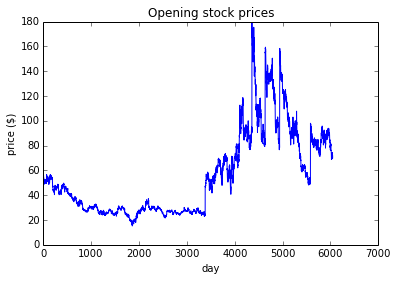

In [15]:
if __name__ == '__main__':
    prices = get_prices('MSFT', '1992-07-22', '2016-07-22')
    plot_prices(prices)
    actions = ['Buy', 'Sell', 'Hold']
    hist = 200
    # policy = RandomDecisionPolicy(actions)
    policy = QLearningDecisionPolicy(actions, hist + 2)
    budget = 1000.0
    num_stocks = 0
    avg, std = run_simulations(policy, budget, num_stocks, prices, hist)
    print(avg, std)